<a href="https://colab.research.google.com/github/ZykinaViktoriya/Python_for_analytics/blob/main/Lection4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [7]:
import pandas as pd
import numpy as np

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns

In [9]:
# df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Python for analytics/test.csv', sep=';')
# df

In [10]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Python for analytics/banking.csv')
df.sample(15)

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp_var_rate,cons_price_idx,cons_conf_idx,euribor3m,nr_employed,y
33257,48,blue-collar,single,basic.9y,no,no,no,cellular,nov,wed,...,2,999,0,nonexistent,-0.1,93.200,-42.0,4.120,5195.8,0
11264,39,admin.,divorced,university.degree,no,no,no,cellular,aug,mon,...,2,999,0,nonexistent,1.4,93.444,-36.1,4.965,5228.1,0
17222,33,technician,married,professional.course,no,no,no,cellular,aug,tue,...,2,999,0,nonexistent,1.4,93.444,-36.1,4.966,5228.1,0
5365,35,admin.,single,university.degree,no,yes,no,cellular,may,wed,...,2,999,0,nonexistent,-1.8,92.893,-46.2,1.270,5099.1,0
26601,31,self-employed,married,university.degree,no,no,no,cellular,sep,wed,...,1,999,0,nonexistent,-3.4,92.379,-29.8,0.768,5017.5,0
6325,33,blue-collar,single,basic.9y,no,no,no,telephone,jun,mon,...,2,999,0,nonexistent,1.4,94.465,-41.8,4.960,5228.1,0
35046,29,admin.,single,university.degree,no,no,no,cellular,jun,tue,...,2,999,0,nonexistent,-2.9,92.963,-40.8,1.286,5076.2,1
38609,32,technician,married,university.degree,no,no,no,cellular,aug,fri,...,2,999,0,nonexistent,1.4,93.444,-36.1,4.963,5228.1,0
40060,26,technician,married,unknown,no,no,no,cellular,may,fri,...,2,999,0,nonexistent,-1.8,92.893,-46.2,1.250,5099.1,0
36430,32,technician,married,university.degree,no,no,no,cellular,aug,thu,...,1,999,0,nonexistent,1.4,93.444,-36.1,4.968,5228.1,0


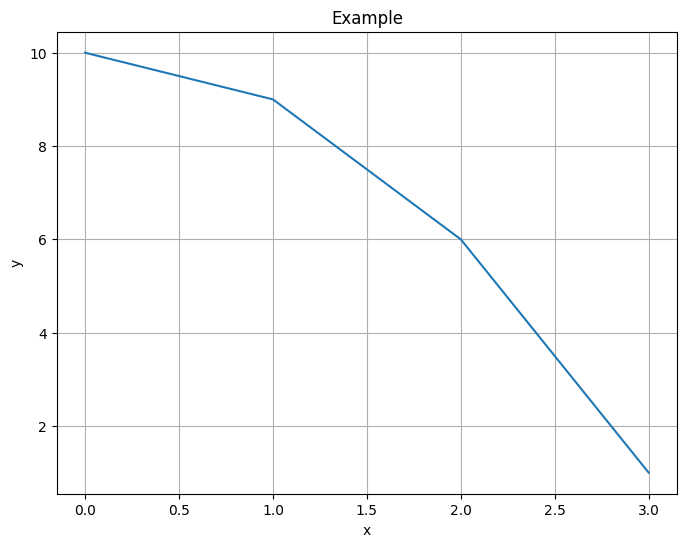

In [11]:
plt.figure(figsize=(8,6))
plt.plot([0,1,2,3], [10,9,6,1])
plt.xlabel('x')
plt.ylabel('y')
plt.title('Example')
plt.grid();
# grid это сетка

# Виды графиков

## Линейный график

Matplotlib - plt.plot()

Seaborn - sns.lineplot()

In [12]:
data = df.groupby('month')['job'].agg(count='count').reset_index().sort_values(by='month')
data.head()

,month,count
0,apr,2632
1,aug,6178
2,dec,182
3,jul,7174
4,jun,5318


## Matplotlib

Text(0, 0.5, 'Кол-во клиентов')

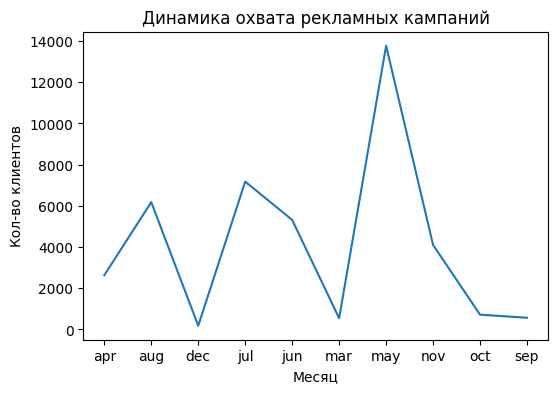

In [13]:
plt.figure(figsize=(6,4))

plt.plot(data['month'], data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов')

## Seaborn

Text(0, 0.5, 'Кол-во клиентов')

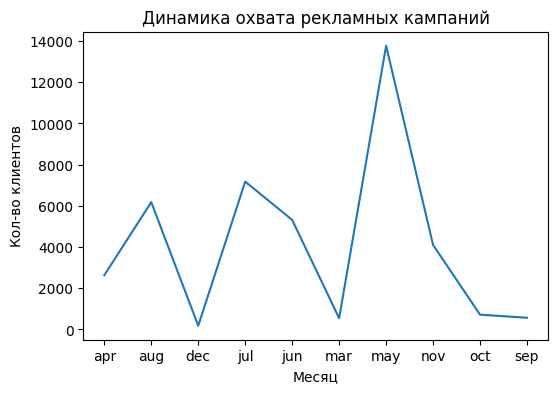

In [14]:
plt.figure(figsize=(6,4))

sns.lineplot(x=data['month'], y=data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов')

### Гисторамма

### Matplotlib

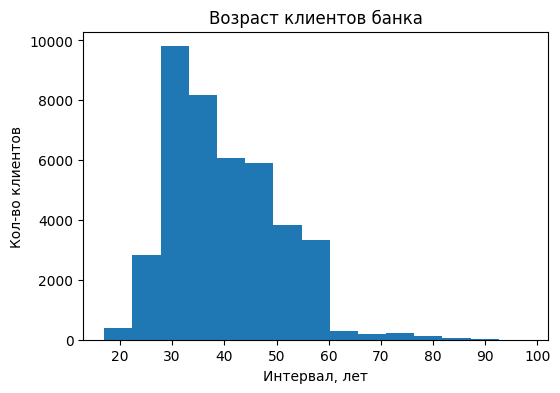

In [15]:
plt.figure(figsize=(6,4))

plt.hist(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');


### Seaborn

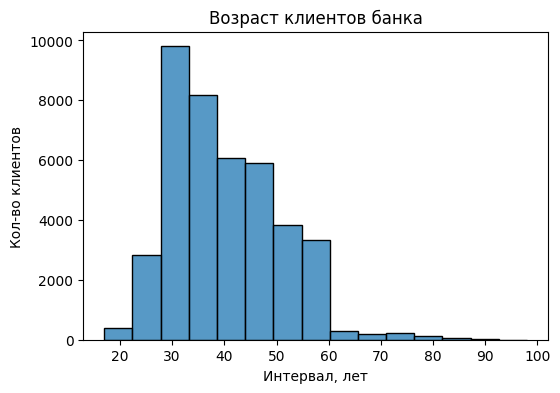

In [16]:
plt.figure(figsize=(6,4))

sns.histplot(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

### Диаграмма рассеяния  Scatterplot

In [17]:
data = df.groupby('age')['y'].sum().reset_index()
data.head()

,age,y
0,17,2
1,18,12
2,19,20
3,20,23
4,21,29


### Matplotlib

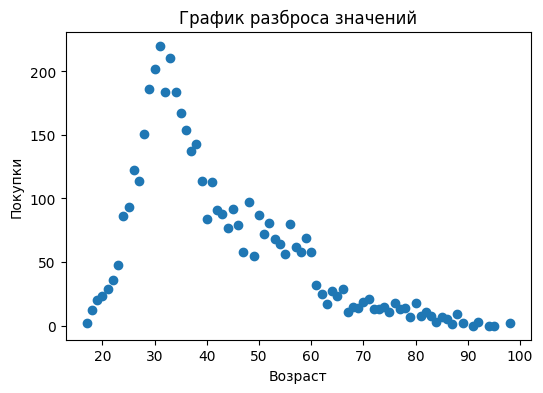

In [18]:
plt.figure(figsize=(6,4))

plt.scatter(data['age'], data['y'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

### Seaborn

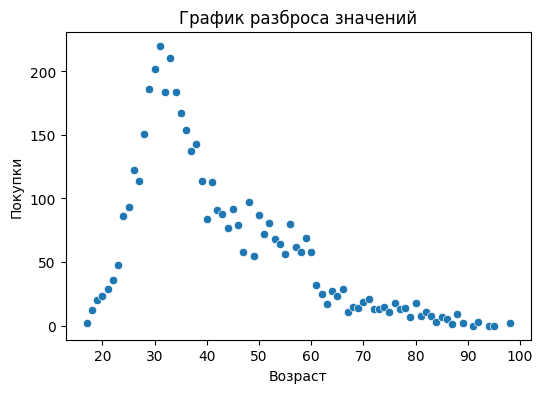

In [19]:
plt.figure(figsize=(6,4))

sns.scatterplot(x=data['age'], y=data['y'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

## Столбчатые диаграммы - bar



In [20]:
data=df['job'].value_counts().reset_index()
data.head()

,index,job
0,admin.,10422
1,blue-collar,9254
2,technician,6743
3,services,3969
4,management,2924


### Matplotlib

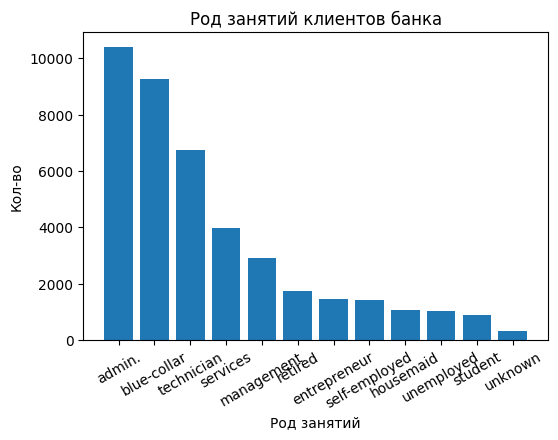

In [21]:
plt.figure(figsize=(6,4))

plt.bar(data['index'], data['job'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

### Seaborn

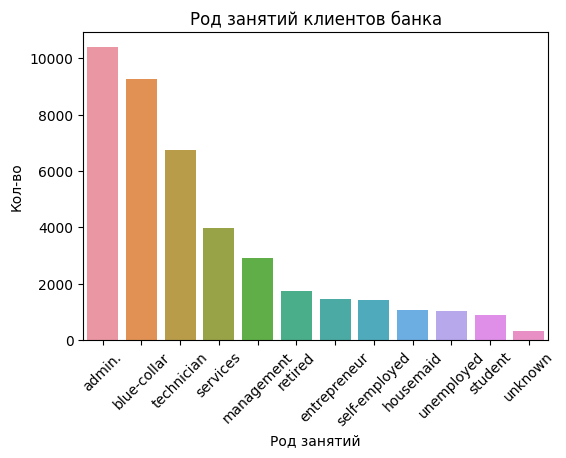

In [22]:
plt.figure(figsize=(6,4))

sns.barplot(x=data['index'], y=data['job'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=45);

## Многорядовые столбчатые диаграммы

In [23]:
data = pd.crosstab(df['job'], df['y']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

y,job,no,yes
0,admin.,9070,1352
1,blue-collar,8616,638
9,technician,6013,730
7,services,3646,323
4,management,2596,328


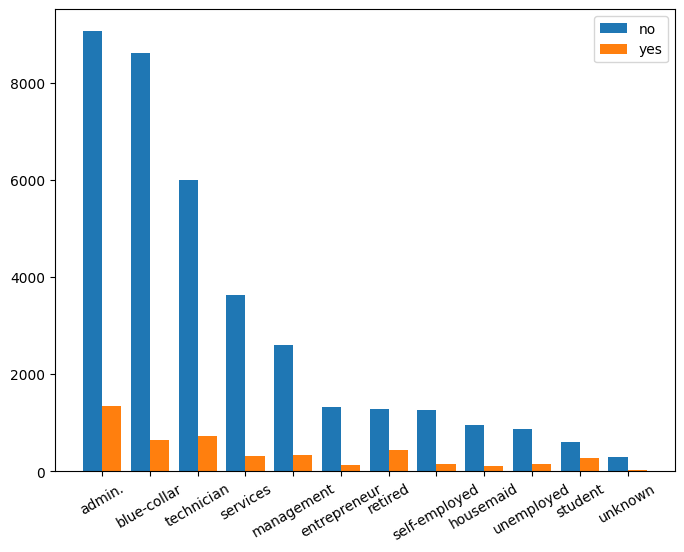

In [24]:
plt.figure(figsize=(8,6))

# определяем количество делений
n_ticks = np.arange(len(data['no']))

# определяем сдвиг
offset = 0.2

# определяем ширину столбцов
w = 0.4

# добавляем сдвиг к количеству делений
plt.bar(n_ticks - offset, data['no'], width = w)
plt.bar(n_ticks + offset, data['yes'], width = w)

plt.title('')
plt.xlabel('')
plt.ylabel('')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['job'], rotation = 30);

## Сложенная столбчатая диаграмма

In [25]:
data = pd.crosstab(df['job'], df['y'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

y,job,no,yes
1,blue-collar,0.931057,0.068943
7,services,0.918619,0.081381
2,entrepreneur,0.914835,0.085165
3,housemaid,0.900000,0.100000
6,self-employed,0.895144,0.104856


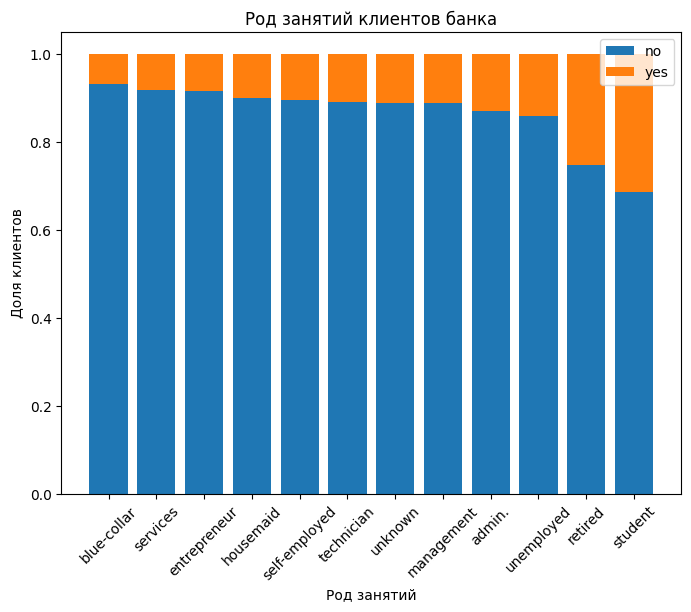

In [26]:
plt.figure(figsize = (8,6))

plt.bar(data['job'], data['no'])
plt.bar(data['job'], data['yes'], bottom=data['no'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Доля клиентов')
plt.legend(['no', 'yes'])
plt.xticks(rotation = 45);

## Ящики с усами

In [27]:
data1 = df['duration'][df['y'] == 1]
data2 = df['duration'][df['y'] == 0]
data1.head()

2      339
4      137
8      174
12     372
16    1034
Name: duration, dtype: int64

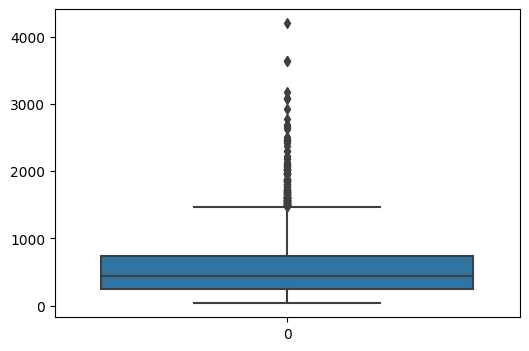

In [28]:
plt.figure(figsize=(6,4))
sns.boxplot(data=[data1]);


<Axes: xlabel='duration', ylabel='Count'>

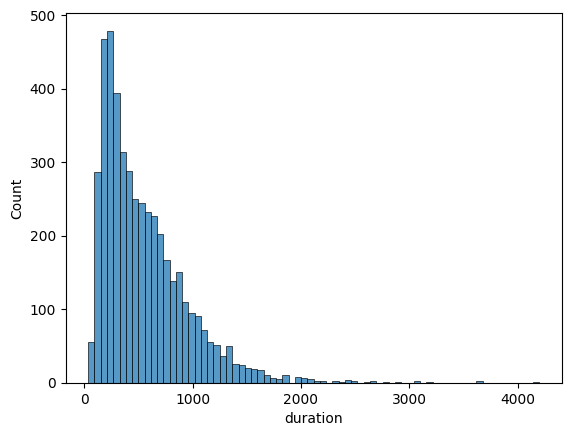

In [29]:
sns.histplot(x=data1)

## Matplotlib

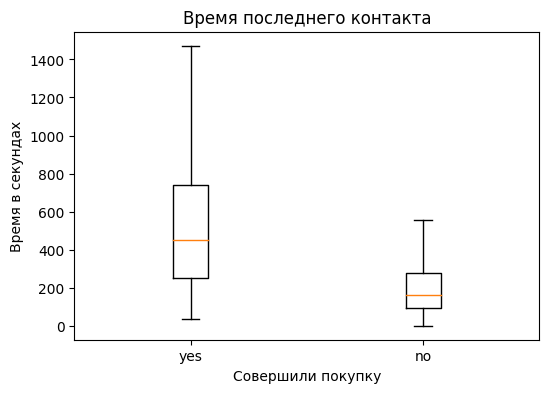

In [30]:
plt.figure(figsize=(6,4))

plt.boxplot([data1, data2], showfliers=False)

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

## Seaborn

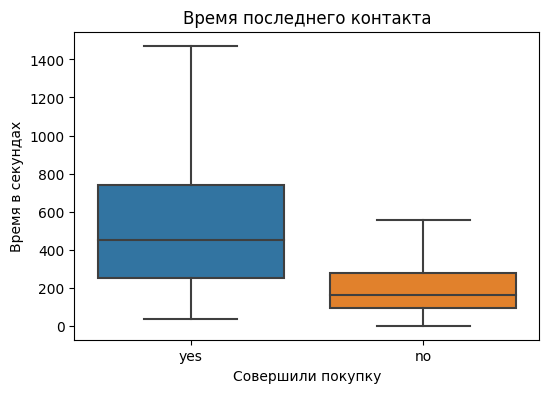

In [31]:
plt.figure(figsize=(6,4))

sns.boxplot(data=[data1, data2], showfliers=False)

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([0,1], ['yes', 'no']);

## Круговая диаграмма - pie

In [32]:
data = df['y'].value_counts()
data.index = ['no', 'yes']
data.head()

no     36548
yes     4640
Name: y, dtype: int64

### Matplotlib

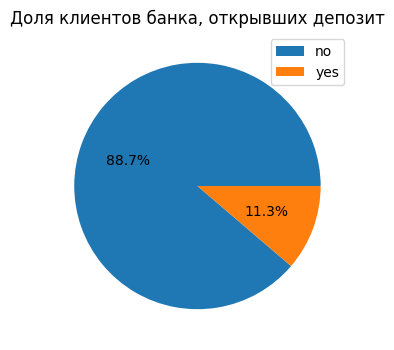

In [33]:
plt.figure(figsize=(6,4))

plt.pie(data, autopct='%1.1f%%')

plt.title('Доля клиентов банка, открывших депозит')
plt.legend(data.index);

# Визуальный анализ данных

In [34]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Python for analytics/housing.csv')
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


### Распределение вещественных признаков

{'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')

[0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)

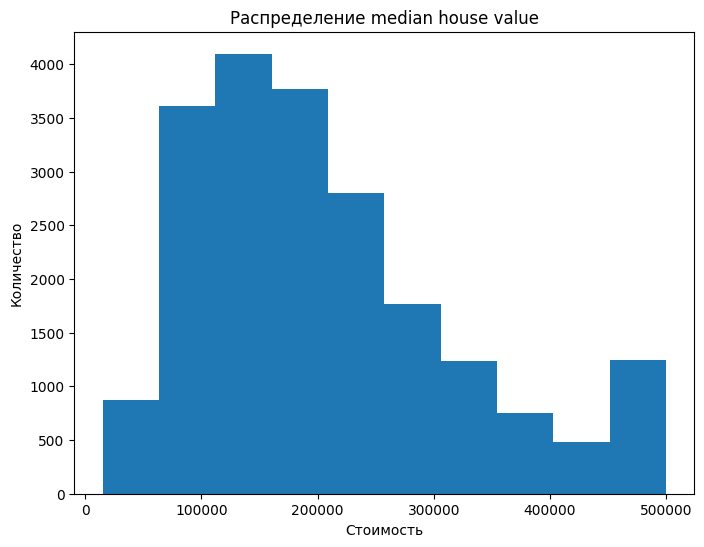

In [35]:
plt.figure(figsize=(8,6))
plt.hist(df['median_house_value'])
plt.title('Распределение median house value')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

In [36]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features.drop('median_house_value', axis=1, inplace=True)

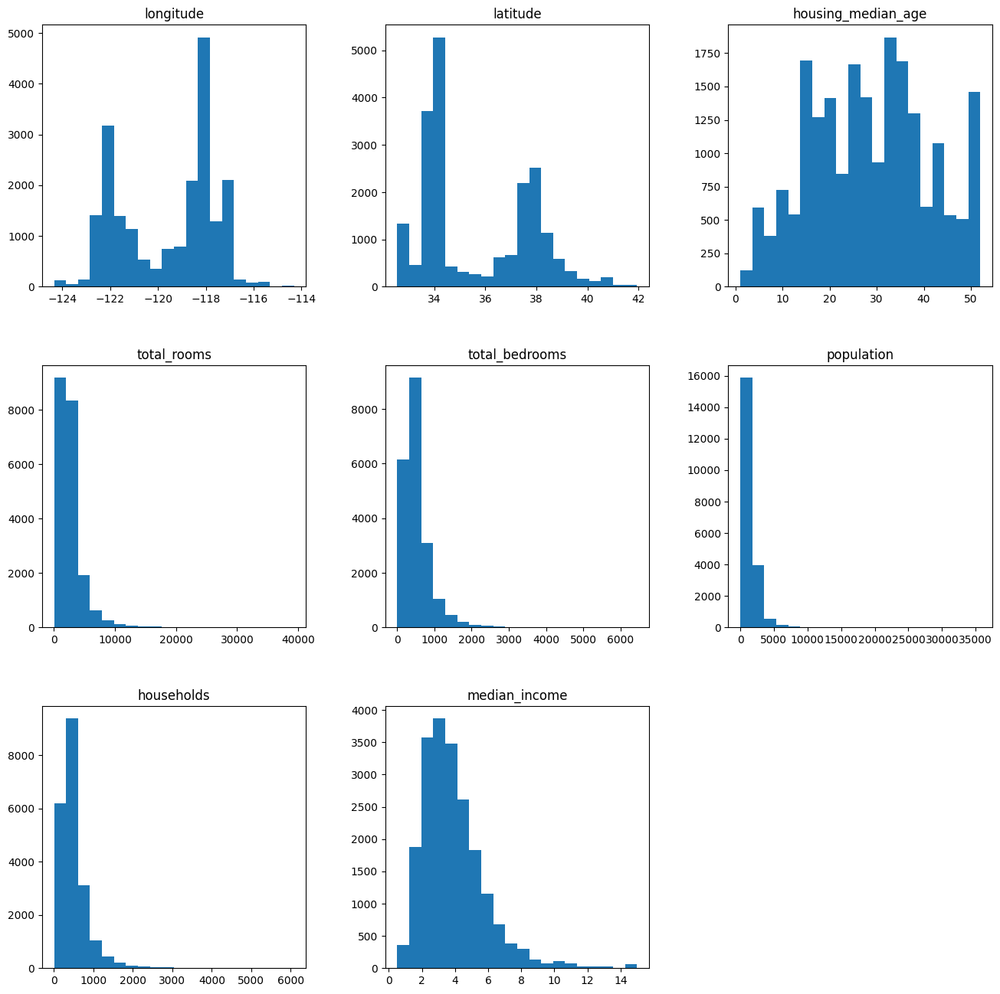

In [37]:
df_num_features.hist(figsize=(16,16), bins=20, grid=False);

Поиск выбросов с помощью box plot

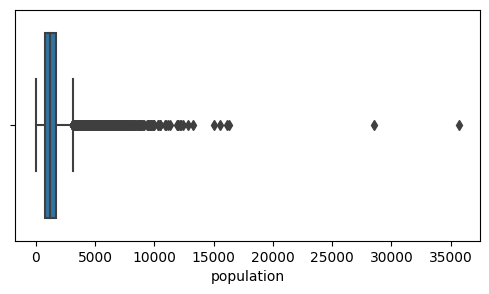

In [38]:
plt.figure(figsize=(6,3))
sns.boxplot(x=df['population'], whis=1.5)
plt.xlabel('population')
plt.show()

## Анализ категориальных признаков

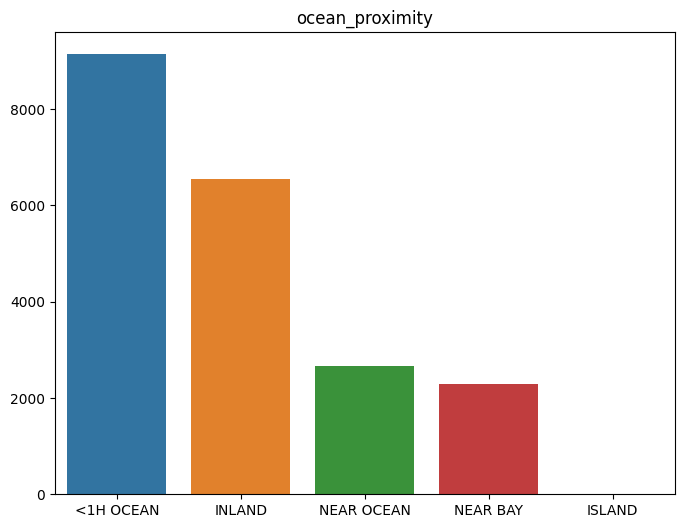

In [39]:
counts = df['ocean_proximity'].value_counts()

plt.figure(figsize=(8,6))
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values)

plt.show()

### Анализ взаимных распределений

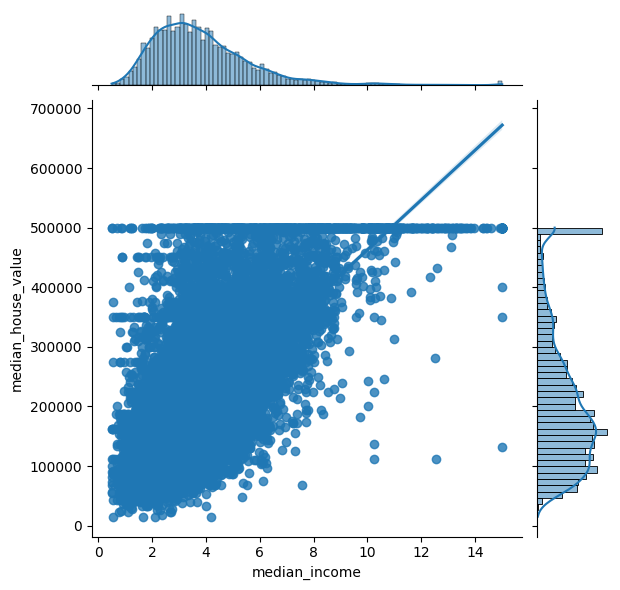

In [40]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg')

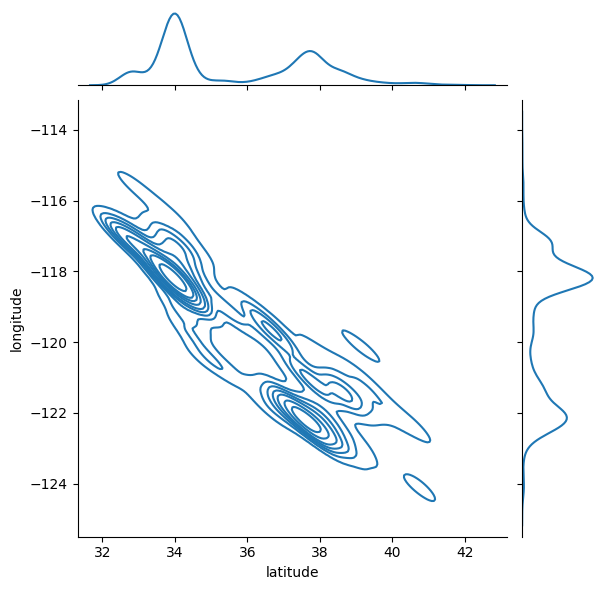

In [41]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde');

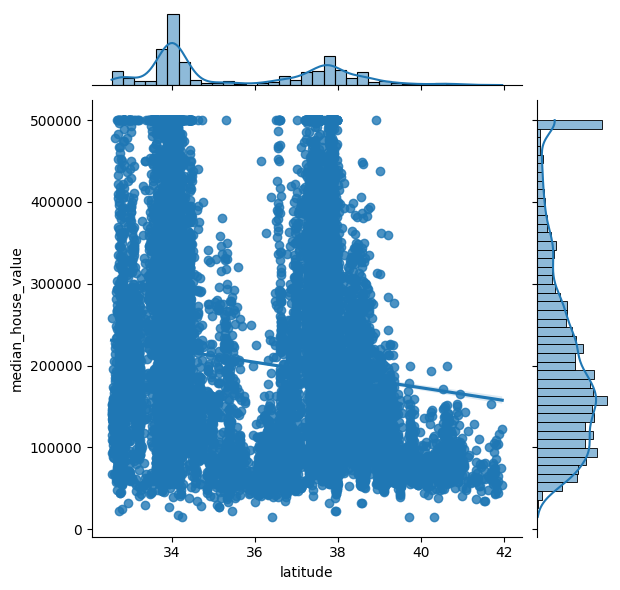

In [42]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');

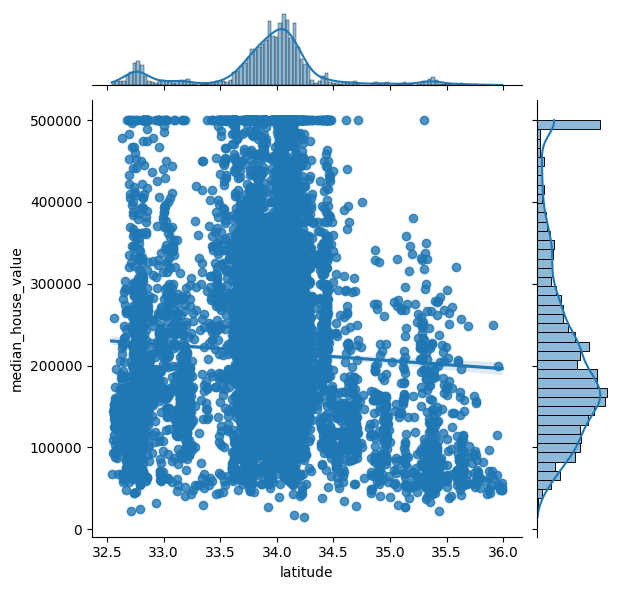

In [43]:
df_cut=df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

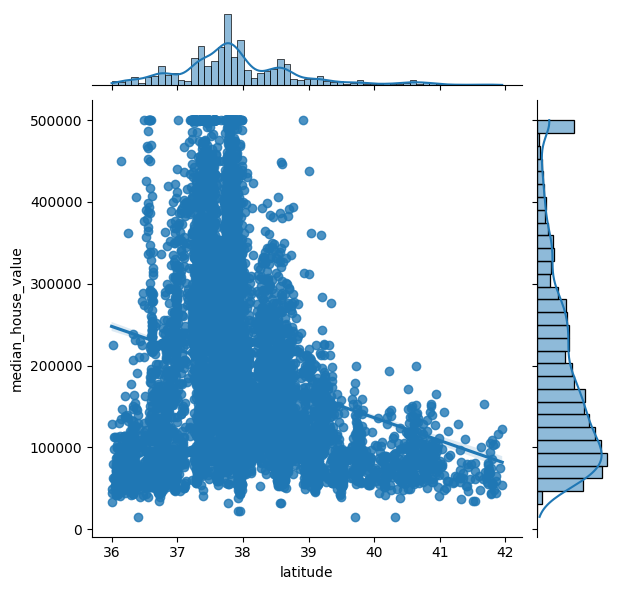

In [44]:
df_cut=df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

### Категориальные/ бинарные признаки

### box plot

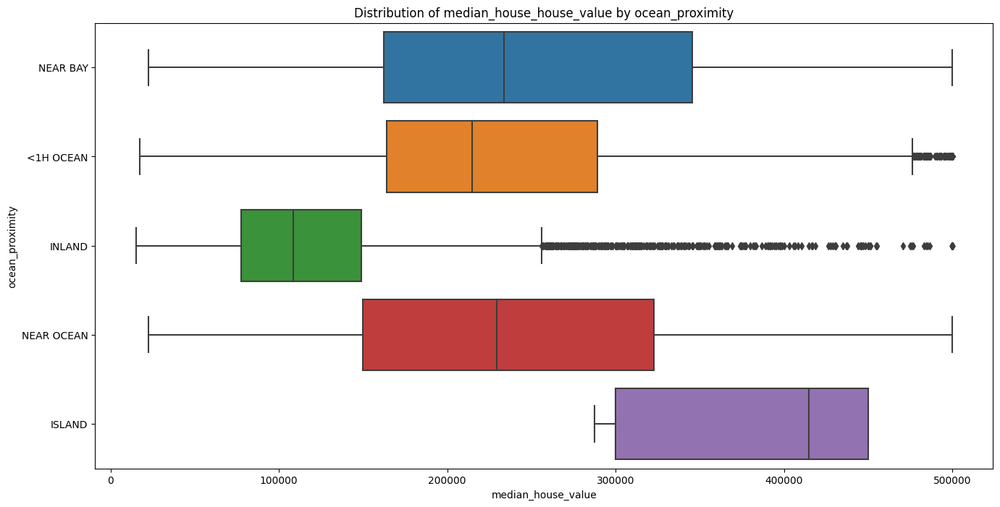

In [45]:
plt.figure(figsize=(16,8))

sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5)

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_house_value by ocean_proximity');

### Матрица корреляций

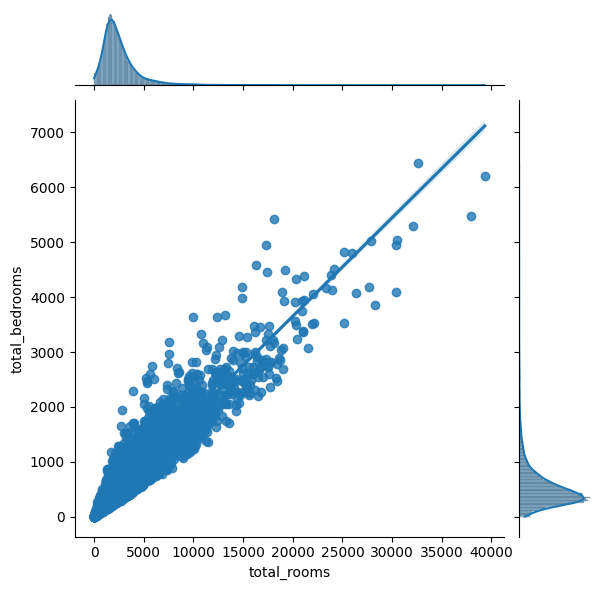

In [46]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

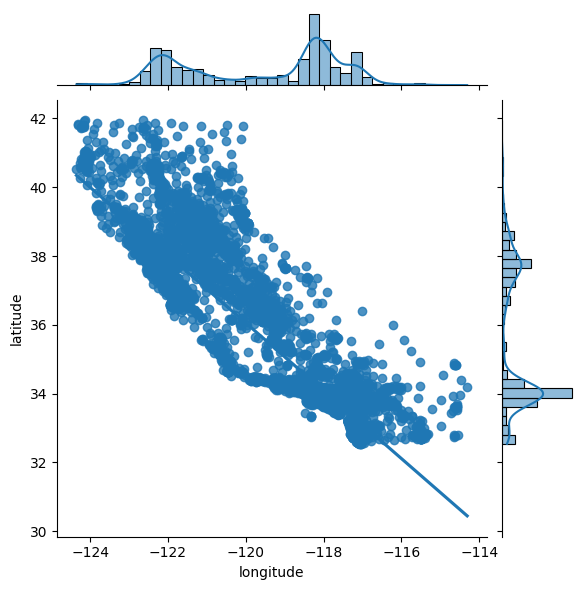

In [47]:
sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');

In [48]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

<ipython-input-48-a439e4510211>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.0,-0.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0
latitude,-0.9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
housing_median_age,0.0,0.0,1.0,-0.4,-0.3,-0.3,-0.3,0.0,0.0
total_rooms,0.0,0.0,-0.4,1.0,0.9,0.9,0.9,0.0,0.0
total_bedrooms,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
population,0.0,0.0,-0.3,0.9,0.9,1.0,0.9,0.0,0.0
households,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
median_income,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.7
median_house_value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7,1.0


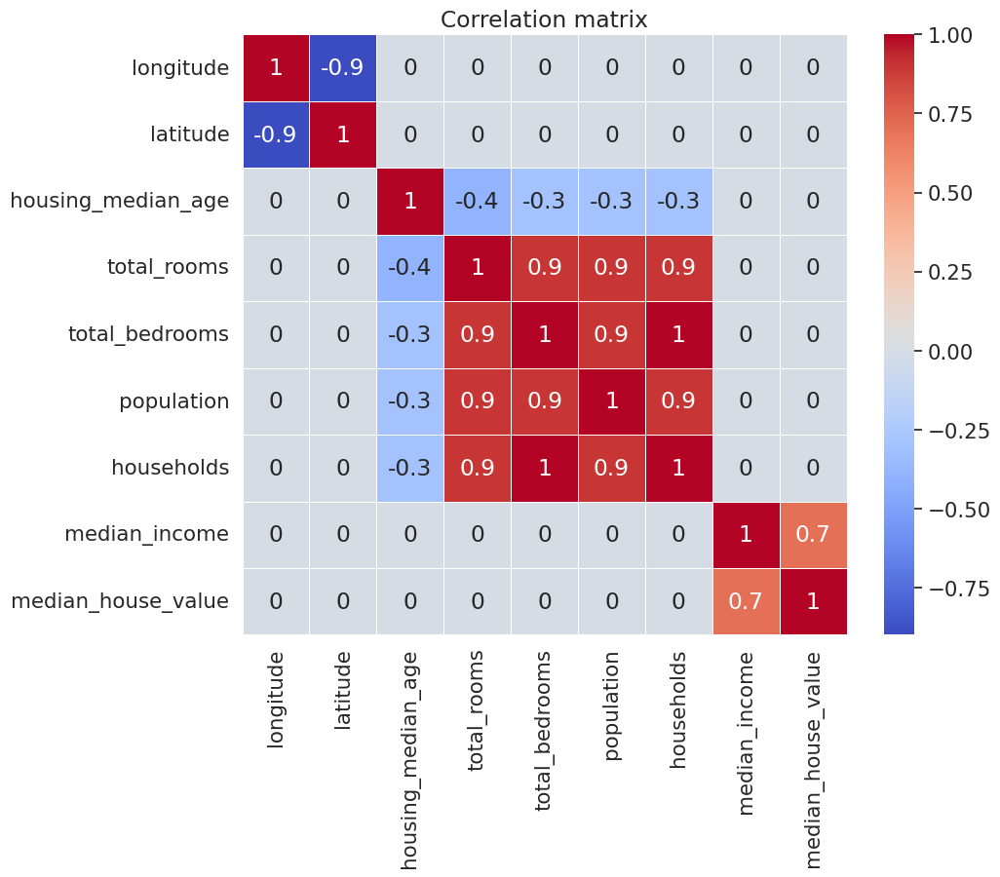

In [49]:
plt.figure(figsize=(10,8))

sns.set(font_scale=1.4)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix');

## Анализ геоданных

In [50]:
min_long = -124.55
max_long = -113.80

min_lat = 32.45
max_lat = 42.05

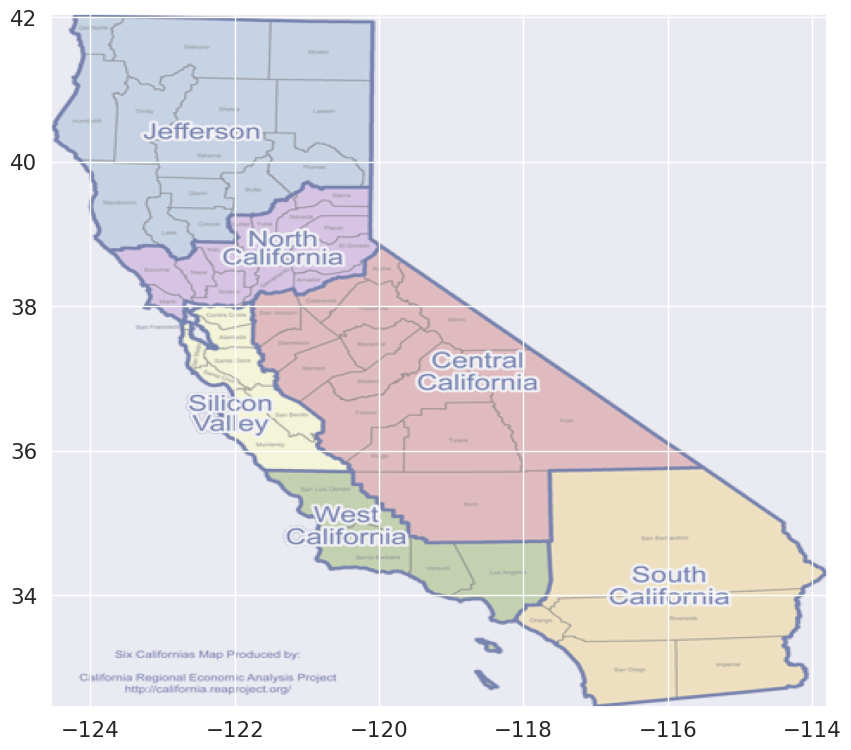

In [51]:
import matplotlib.image as img
california_map = img.imread('/content/drive/MyDrive/Colab Notebooks/Python for analytics/transparent-california-179.png')

plt.figure(figsize=(12,9))
plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5);

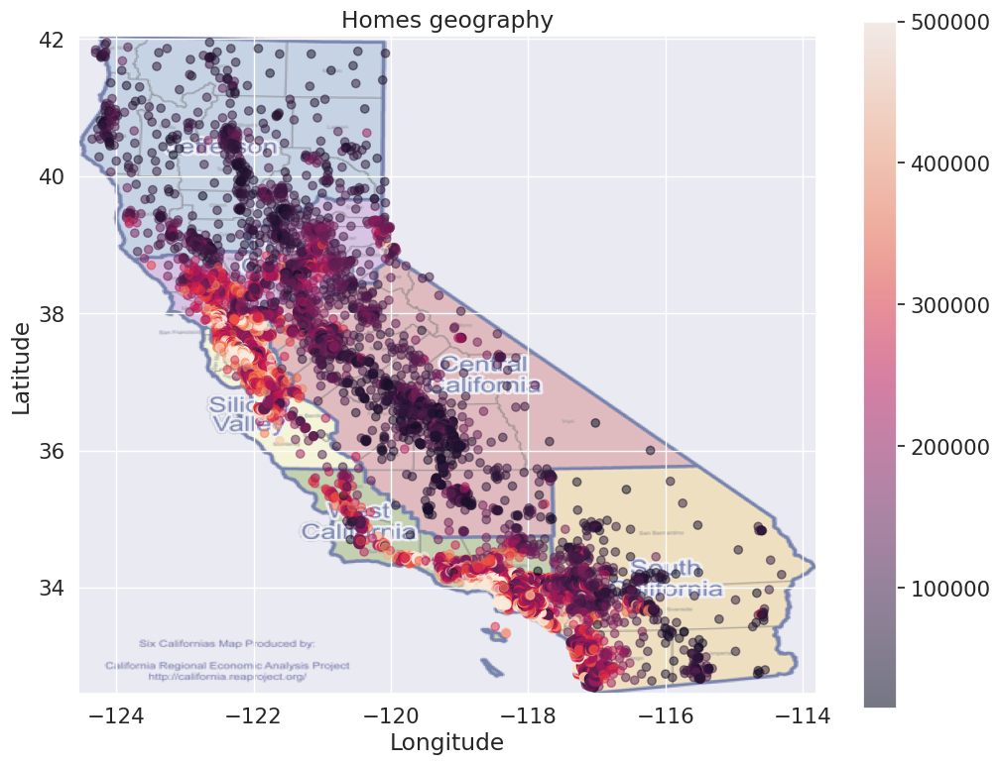

In [52]:
plt.figure(figsize=(12,9))

sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value'])

plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5)

plt.colorbar(sc)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Homes geography');

### Folium для динамического анализа точек на карте

In [54]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
  folium.CircleMarker(
      location=[point.latitude, point.longitude],
      radius=2,
      popup=point.median_house_value
  ).add_to(this_map)

df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

## Kepler

In [58]:
!pip install keplergl==0.1.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 14.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 30.4 MB/s eta 0:00:00
  Created wheel for keplergl: filename=keplergl-0.1.1-py2.py3-none-any.whl size=10798674 sha256=eac708324f7d66600dcc392fe6db97126eacad401727ad790fa17384b24b861c
  Stored in directory: /root/.cache/pip/wheels/9b/c8/cf/c0c5b928fae4588e453789a53681c511479fa1f3f665f75b6e
Successfully built keplergl


In [61]:
from keplergl import KeplerGl

map_ = KeplerGl(height=700)
map_.add_data(df,'Data')
map_.save_to_html(file_name='./california.html')

User Guide: https://github.com/keplergl/kepler.gl/blob/master/docs/keplergl-jupyter/user-guide.md
Map saved to ./california.html!
